In [1]:
import os
import torch
import numpy as np
from PIL import Image, ImageDraw, ImageFont
import cv2
from typing import Optional, Union, Tuple, List, Callable, Dict
from IPython.display import display, HTML
from tqdm.notebook import tqdm
import torch.nn.functional as nnf
from diffusers import DiffusionPipeline
import abc
from ProT2I.processors import *
import matplotlib.pyplot as plt
from torchvision.utils import save_image
from config import  *
import random

def custom_repr(self):
    return f'{{Tensor:{tuple(self.shape)}}} {original_repr(self)}'
original_repr = torch.Tensor.__repr__
torch.Tensor.__repr__ = custom_repr

In [2]:
def text_under_image(image: np.ndarray, text: str, text_color: Tuple[int, int, int] = (0, 0, 0)):
    h, w, c = image.shape
    offset = int(h * .2)
    img = np.ones((h + offset, w, c), dtype=np.uint8) * 255
    font = cv2.FONT_HERSHEY_SIMPLEX
    img[:h] = image
    textsize = cv2.getTextSize(text, font, 1, 2)[0]
    text_x, text_y = (w - textsize[0]) // 2, h + offset - textsize[1] // 2
    cv2.putText(img, text, (text_x, text_y ), font, 1, text_color, 2)
    return img

def view_images(images, num_rows=1, offset_ratio=0.02):
    if type(images) is list:
        if isinstance(images[0], Image.Image):
            h, w = images[0].size
            images = [np.array(img) for img in images]
        num_empty = len(images) % num_rows
    elif images.ndim == 4:
        num_empty = images.shape[0] % num_rows
    else:
        images = [images]
        num_empty = 0

    empty_images = np.ones(images[0].shape, dtype=np.uint8) * 255
    images = [image.astype(np.uint8) for image in images] + [empty_images] * num_empty
    num_items = len(images)

    h, w, c = images[0].shape
    offset = int(h * offset_ratio)
    num_cols = num_items // num_rows
    image_ = np.ones((h * num_rows + offset * (num_rows - 1),
                      w * num_cols + offset * (num_cols - 1), 3), dtype=np.uint8) * 255
    for i in range(num_rows):
        for j in range(num_cols):
            image_[i * (h + offset): i * (h + offset) + h:, j * (w + offset): j * (w + offset) + w] = images[
                i * num_cols + j]

    pil_img = Image.fromarray(image_)
    display(pil_img)


    
def aggregate_attention(attention_store: AttentionStore, res: int, from_where: List[str], is_cross: bool, select: int):
    out = []
    attention_maps = attention_store.get_average_attention()
    num_pixels = res ** 2
    for location in from_where:
        for item in attention_maps[f"{location}_{'cross' if is_cross else 'self'}"]:
            if item.shape[1] == num_pixels:
                cross_maps = item.reshape(len(sps), -1, res, res, item.shape[-1])[select]
                out.append(cross_maps)
    out = torch.cat(out, dim=0)
    out = out.sum(0) / out.shape[0]
    return out.cpu()


def show_cross_attention(attention_store: AttentionStore, res: int, from_where: List[str], controller_index: int, select: int = 0, words: List[str] = None, is_cross: bool = True, save_dir: str = None):
    if save_dir:
        os.makedirs(save_dir, exist_ok=True)
    
    tokens = tokenizer.encode(controller_np[controller_index][select])
    decoder = tokenizer.decode
    attention_maps = aggregate_attention(attention_store, res, from_where, is_cross, select) * 100
    images = []
    if words:
        token_texts = [decoder(int(token)) for token in tokens]
        token_indices = [i for i, text in enumerate(token_texts) if text in words]
    else:
        token_indices = range(len(tokens))
    
    for i in token_indices:
        image = attention_maps[:, :, i]
        image = (image - image.min()) / (image.max() - image.min())  
        image = 255 * (image ** 0.85) 
        image = image.unsqueeze(-1).expand(*image.shape, 3)
        image = image.numpy().astype(np.uint8)
        image = np.array(Image.fromarray(image).resize((256, 256)))
        image = text_under_image(image, decoder(int(tokens[i])))
        images.append(image)
        
        if save_dir:
            filename = os.path.join(save_dir, f"{decoder(int(tokens[i]))}_{i}.png")
            Image.fromarray(image).save(filename)
        
    view_images(np.stack(images, axis=0))

def show_images(desc:List[str], images:List, num_rows:int=1, Offset_ratio:float=0.02):
    imgs = []
    assert len(desc) == len(images), "Length of desc and images should be equal."
    for i, image in enumerate(images):
        if isinstance(image, Image.Image):
            image = np.array(image.resize((256, 256)))
        image = text_under_image(image, desc[i])
        imgs.append(image)
    view_images(np.stack(imgs, axis=0), num_rows=num_rows,offset_ratio=Offset_ratio)
        

def show_self_attention(attention_stores:List[AttentionStore], from_where: str, layers:int):
    top_components = []
    # the first self attention map
    first_attention_map = attention_stores[0].get_average_attention()[from_where][layers][:8].mean(dim=0)
    U, S, V = torch.svd(first_attention_map.to(torch.float32))
    top_U = U[:, :6]
    top_components.append(top_U)
    for i, attention_store in enumerate(attention_stores, start=0):
        attention_map = (attention_store.get_average_attention()[from_where][layers][8:]).mean(dim=0).to(torch.float32)
        U, S, V = torch.svd(attention_map)
        top_U = U[:,:6]
        top_components.append(top_U)

    for batch_idx, components in enumerate(top_components):
        plt.figure(figsize=(24, 4))
        for comp_idx in range(6):
            plt.subplot(1, 6, comp_idx + 1)
            component = components[:,comp_idx].reshape(32,32).to('cpu')
            plt.imshow(component, cmap='viridis')
            # plt.colorbar()
            plt.axis('off')
            plt.title(f'prompt {batch_idx + 1} Top {comp_idx + 1}')
        plt.tight_layout()
        plt.show()


## SDXL

In [3]:
from ProT2I.prot2i_pipeline_sdxl import ProT2IPipeline
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')
if device.type == "cuda":
    pipe = ProT2IPipeline.from_pretrained("SG161222/RealVisXL_V4.0",
                                                torch_dtype=torch.float16, use_safetensors=True).to(device)
else:
    pipe = ProT2IPipeline.from_pretrained("SG161222/RealVisXL_V4.0",
                                                torch_dtype=torch.float32, use_safetensors=False).to(device)

tokenizer = pipe.tokenizer

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

### Style composition

seed  962845
<class 'ProT2I.prot2i_pipeline_sdxl.ProT2IPipeline'>


  0%|          | 0/50 [00:00<?, ?it/s]

Iteration 1, Loss:27.4219
Iteration 2, Loss:27.3750
Iteration 3, Loss:27.3594
Iteration 4, Loss:27.3438
Iteration 5, Loss:27.3281
Iteration 6, Loss:27.3438
Entropy loss optimization Exceeded max number of iterations (6) 
Step Interation: 6 | loss: 27.34375
Processing words: dog
True rate: 0.25970458984375
Processing words: car
True rate: 0.13677978515625
Iteration 1, Loss:27.2969
Iteration 2, Loss:27.3125
Iteration 3, Loss:27.2812
Iteration 4, Loss:27.2812
Iteration 5, Loss:27.2812
Iteration 6, Loss:27.2969
Entropy loss optimization Exceeded max number of iterations (6) 
Step Interation: 6 | loss: 27.296875
Processing words: dog
True rate: 0.257568359375
Processing words: car
True rate: 0.14007568359375
Iteration 1, Loss:27.2969
Iteration 2, Loss:27.2812
Iteration 3, Loss:27.2812
Iteration 4, Loss:27.2812
Iteration 5, Loss:27.2812
Iteration 6, Loss:27.2969
Entropy loss optimization Exceeded max number of iterations (6) 
Step Interation: 6 | loss: 27.296875
Processing words: dog
True ra

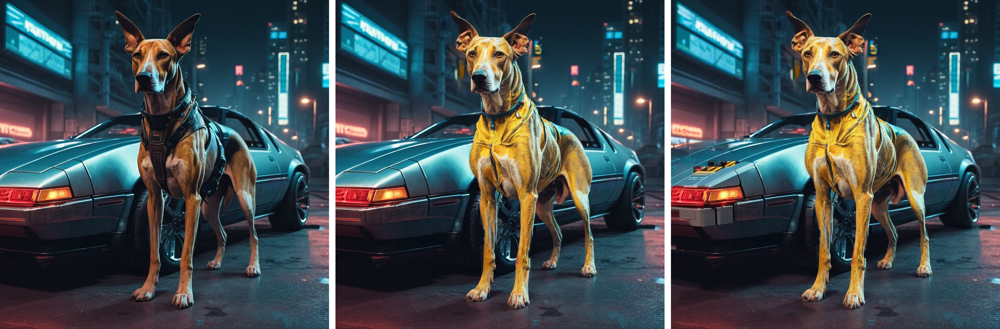

In [7]:
config = SDXLConfig()
seed = random.randint(0,1000000)
print("seed ", seed)
g_cpu = torch.Generator().manual_seed(seed)

prompt = "In a cyberpunk style city night, a Van Gogh style hound dog is standing in front of a lego style sports car"
sps=[
    "In a cyberpunk style city night, a hound dog is standing in front of a sports car",
    "Van Gogh style hound dog ",
    "Lego-style sports car"
]
nps = [
    "dog",
    "car"
]
use_nurse = True

assert len(nps)+1 == len(sps)

if use_nurse:
    nursing_tokens = nps
else:
    nursing_tokens = None

# make controllers
controller_list = []
controller_np = [[sps[i-1],sps[i]] for i in range(1, len(sps))]
for i in range(len(controller_np)):
    controller_kwargs = {
        "edit_type": "refine",
        "local_blend_words": nps[i],
        "n_cross_replace": {"default_": 0.0},
        "n_self_replace": 0.8,
        "lb_threshold": 1.3,
        "lb_prompt": [sps[0]]*2,
        "is_nursing": use_nurse,
        "lb_res": (32,32),
        "save_map": False,
    }
    controller = create_controller(
        prompts=controller_np[i],
        cross_attention_kwargs=controller_kwargs,
        num_inference_steps=50,
        tokenizer=pipe.tokenizer,
        device=device, 
        attn_res=(32,32)
    )
    controller_list.append(controller)


# if you mannualy decompose the complex prompt, you can use `cross_attention_kwargs` to input the sps and controllers
cross_attention_kwargs = {
    "subprompts": sps,
    "set_controller": controller_list,
    "subject_words": nursing_tokens,
    "nursing_threshold": config.nursing_thresholds,
    "max_refinement_steps": config.max_refinement_steps,
    "scale_factor": config.scale_factor,
    "scale_range":config.scale_range,
    "use_AdaPose":config.use_adapose,
    "angle_loss_weight":config.angle_loss_weight,
    }

print(type(pipe))
prot2i_output = pipe(prompt= prompt, 
            width = 1024,
            height = 1024,
            cross_attention_kwargs=cross_attention_kwargs, 
            num_inference_steps=50, 
            num_images_per_prompt=1,
            generator=g_cpu,
            attn_res = (32,32),
            )
view_images(prot2i_output[0]["images"])

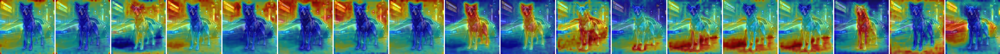

In [22]:
controller = prot2i_output[1][0]
vis_utils.show_cross_attention(attention_store=controller,
                                prompt=sps[0],
                                tokenizer=pipe.tokenizer,
                                res=32,
                                from_where=("down", ),
                                subject_words=sps[0],
                                bs=2,
                                select=0,
                                orig_image=prot2i_output[0]["images"][0],
                                text_under_img=False,
                                )

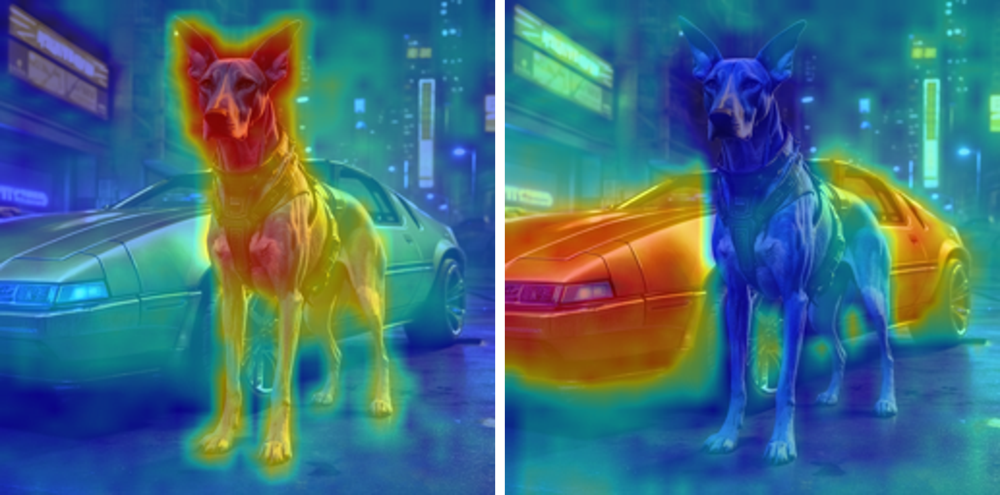

In [29]:
controller = prot2i_output[1][0]
vis_utils.show_cross_attention(attention_store=controller,
                                prompt=sps[0],
                                tokenizer=pipe.tokenizer,
                                res=32,
                                from_where= ("up","mid","down"),
                                subject_words=['dog','car'],
                                bs=2,
                                select=0,
                                orig_image=prot2i_output[0]["images"][0],
                                text_under_img=False,
                                )